In [1]:
# modulos y librerias

import pandas as pd
import numpy as np
import nltk
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
# from keras.preprocessing.sequence import pad_sequences
from nltk.corpus import stopwords
from gensim.models import Word2Vec
import time
import collections


import plotly.graph_objects as go
import matplotlib.pyplot as plt
pd.options.display.max_columns = None
pd.options.display.max_rows = None


In [2]:
catalog.list()

['hado_22',
 'hado_21',
 'hado_20',
 'hado_19',
 'hado_18',
 'hado_17',
 'hado_concat',
 'hado_concat_clean',
 'hado_values',
 'parameters']

In [3]:
df = catalog.load('hado_concat_clean')

[06/29/23 15:26:41] INFO     Loading data from 'hado_concat_clean' (CSVDataSet)...              data_catalog.py:345

Una vez se haya realizado la limpieza y preprocesamiento realizamos los siguientes pasos:

# 1. Vectorización de texto

La vectorización de texto es el proceso de convertir palabras en vectores numéricos que pueden ser entendidos y procesados por un algoritmo de machine learning. Existen diferentes técnicas para hacer esto, entre las que se incluyen Bag of Words, TF-IDF, y Word2Vec.

>Word2Vec es un método que utiliza redes neuronales para aprender representaciones vectoriales de palabras a partir de un corpus de texto. Este método tiene la ventaja de que puede capturar el significado semántico de las palabras.

Tenemos que convertir los diagnosticos en una lista de listas haciendo un split de la variable 
```python
diagnosticos = df['diagnosticos'].unique()`
```
Utilizaremos para los vectores
1. **Máximo**: En lugar de tomar el promedio de los vectores de palabras, puedo tomar el máximo de cada componente de los vectores de palabras. Este enfoque podría capturar la "palabra más importante" en cada dimensión del espacio vectorial.

2. **Suma**:Podría sumar los vectores de las palabras, lo que daría más peso a los diagnósticos con más palabras.

3. **Promedio**:Promediando los vectores de todas las palabras en cada diagnóstico.

4. **Concatenación**:si el tamaño de los vectores es pequeño, podría considerarse concatenar los vectores de las palabras en lugar de promediarlos. Esto resultaría en vectores de diagnóstico más grandes, pero también podría capturar más información.

## 1.1 Stopwords

In [114]:
df\
.isna()\
.sum()

h_procedencia              0
s_procedencia              0
ap                         1
otros                   1056
diagnostico                0
motivo_ing                 0
paliativo_onc_noc          1
paliativo_no_onc_noc       2
fiebre                     2
disnea                     1
dolor                      0
delirium                   1
otros_1                 2465
p_terminal              2467
agonia                  1059
ps_ecog                    1
barthel                    1
gds_fast                   0
eva_ing                 2466
otros_2                 2466
otros_complicaciones    1058
n_estancias                0
n_visitas                  0
sedacion                   5
motivo_alta                0
medico                     1
year                       0
ast_anorx                  0
agudo_estable           1551
cronico_reag            1550
transfusion             1550
paracentesis            1550
toracocentesis          2607
ayuntamiento            1551
fecha_alta    

In [116]:
# Cargamos las stopwords
import nltk
from nltk.corpus import stopwords

# Descargar las stopwords de NLTK
nltk.download('stopwords')

# Obtener las stopwords en español
stopwords_es = stopwords.words('spanish')

# Aplicar la eliminación de stopwords a tu columna de texto
df['diagnostico'] = df['diagnostico']\
                .apply(lambda x: ' '.join([word for word in x.split()\
                                           if word not in (stopwords_es)]))


[nltk_data] Downloading package stopwords to C:\Users\Pablo
[nltk_data]     Villar\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [8]:
df['diagnostico'].to_list()

['cancer orl',
 'melanoma vulvar',
 'cancer broncogenico',
 'cirrosis hepatica',
 'neplasia mama estadio IV',
 'anemia',
 'adenoca pulmon',
 'leucemia linfatica cronica',
 'fx meseta tibial',
 'cancer mama',
 'cancer prostata',
 'cancer prostata',
 'anemia',
 'deterioro general',
 'cancer prostata',
 'tumor cerebral',
 'adenoca colon IV',
 'cancer prostata',
 'cancer colon',
 'cancer prostata',
 'neumonia',
 'niemannpick',
 'sarcoidosis',
 'cancer mama',
 'cancer pancreas',
 'infeccion urinaria fallo cardiaco',
 'infeccion urinaria fallo cardiaco',
 'melanoma fosa nasal',
 'cancer timo',
 'cancer mama',
 'infeccion urinaria fallo cardiaco',
 'cancer prostata',
 'infeccion respiratoria',
 'sdown',
 'bocio intratoracico',
 'sepsisi respiratoria',
 'intolerancia oral',
 'cirrosis hepatica',
 'cancer colon',
 'deterioro general',
 'infeccion urinaria',
 'anemia',
 'esclerosis multiple',
 'demencia fallo multiorganico',
 'cancer parotida',
 'ITU (infeccion tracto urinario)',
 'ulceras mmii'

## 1.2 Split for list of lists

In [53]:
# Hacemos una lista de listas para poder pasar los textos a vectores

diagnosticos = df['diagnostico'].unique()

diagnosticos_split = [diagnostico.split() for diagnostico in diagnosticos]

# Filtro diagnosticos vacíos si existen... 
diagnosticos_split = [diagnostico for diagnostico in diagnosticos_split if diagnostico]

# 2. Word2Vec

Word2Vec es una técnica específica que se utiliza para el aprendizaje automático de representaciones de palabras. En esencia, convierte palabras en vectores de números de tal manera que las palabras con significados similares terminan con vectores similares. Esto permite que las operaciones matemáticas se realicen en palabras, lo que puede ser muy útil para muchas tareas de NLP.



In [12]:
from gensim.models import Word2Vec

# Asumiendo que tus diagnósticos ya están preprocesados y almacenados en una lista de listas,
# donde cada lista interna contiene las palabras de un diagnóstico.
# Por ejemplo: [["neoplasia", "pancreas"], ["adenocarcinoma", "de", "pulmón"], ...]

# Entrenamos el modelo Word2Vec
model = Word2Vec(diagnosticos_split, min_count=1, vector_size=50)

# Ahora podemos obtener el vector de una palabra en particular
vector = model.wv['cancer']

# O incluso obtener la palabra más similar a 'neoplasia'
similar = model.wv.most_similar('cancer')


### En el código anterior, min_count es el número mínimo de veces que una palabra debe aparecer en el corpus para ser incluida en el modelo, y vector_size es la dimensión de los vectores de palabra.

In [13]:
similar

[('mieloproliferativa', 0.5173214077949524),
 ('canal', 0.4592200815677643),
 ('respiratorio', 0.41179999709129333),
 ('dependiente', 0.4032057821750641),
 ('facial', 0.37243109941482544),
 ('gdsfast', 0.37153926491737366),
 ('dcha', 0.3694424629211426),
 ('demencia', 0.36913958191871643),
 ('coma', 0.3670448064804077),
 ('germenes', 0.3642371594905853)]

In [14]:
vector

array([ 0.00030707, -0.0008237 ,  0.01020765,  0.01950892, -0.01898298,
       -0.01814791,  0.01711216,  0.0233025 , -0.01488633, -0.01027429,
        0.01455035, -0.00799726, -0.00694339,  0.01350029, -0.01367716,
       -0.00124712,  0.00700929,  0.0035295 , -0.0215846 , -0.02204699,
        0.01657544,  0.0146876 ,  0.01809814, -0.00136461,  0.01699532,
       -0.0069091 , -0.00475145,  0.01247675, -0.01936552, -0.00763749,
       -0.01495158, -0.00332993,  0.01816802, -0.01322686, -0.00768019,
       -0.00189789,  0.01831318, -0.0121903 ,  0.00100186, -0.01192399,
       -0.01455164,  0.00926893, -0.01847759, -0.00806552,  0.00484316,
        0.00134016, -0.0159875 ,  0.01598439,  0.01282651,  0.01998337],
      dtype=float32)

Word2Vec(diagnosticos_split, min_count=1, vector_size=50): Se está entrenando un modelo Word2Vec con los diagnósticos. La opción min_count=1 significa que las palabras que aparecen al menos una vez en los diagnósticos serán consideradas por el modelo, y vector_size=50 define la dimensionalidad de los vectores de palabras generados por el modelo.

model.wv['cancer']: Devuelve el vector de la palabra 'cancer'. Este vector es un arreglo de 50 números (porque se ha definido vector_size=50) que representa el significado de 'cancer' según lo aprendido por el modelo de los diagnósticos.

model.wv.most_similar('cancer'): Devuelve las palabras más similares a 'cancer' según lo aprendido por el modelo de los diagnósticos. La similitud se mide en términos de la similitud del coseno entre los vectores de palabras.

A tener en cuenta: El modelo Word2Vec necesita una gran cantidad de datos para aprender representaciones de palabras significativas. Si solo existe un pequeño número de diagnósticos, los vectores de palabras generados por el modelo podrían no ser muy significativos. En este caso, se puede considerar el uso de vectores de palabras pre-entrenados, como los disponibles en bibliotecas como spaCy o gensim.

## 2.1 Gensim

Gensim es una biblioteca de Python muy popular para el modelado de temas y el procesamiento del lenguaje natural (NLP). Proporciona implementaciones eficientes y escalables de varios algoritmos de NLP, como Word2Vec, FastText, Latent Semantic Analysis (LSA), Latent Dirichlet Allocation (LDA) y otros.

Gensim es una opción popular para usar Word2Vec por varias razones:

1. **Eficiencia**: Gensim está diseñado para ser eficiente y para manejar grandes conjuntos de datos. Utiliza técnicas como la transmisión de datos y la segmentación de memoria para mantener una huella de memoria baja.

2. **Facilidad de uso**: Gensim proporciona una interfaz simple y directa para el uso de algoritmos de NLP complejos como Word2Vec.

3. **Flexibilidad**: Gensim permite un control detallado sobre los parámetros de los modelos, lo que puede ser útil para ajustar el rendimiento del modelo para tareas específicas.

4. **Comunidad de apoyo**: Gensim es una biblioteca muy utilizada con una gran comunidad de usuarios y desarrolladores. Esto significa que hay una gran cantidad de documentación, tutoriales y soporte disponible.

En cuanto a por qué Word2Vec y Gensim son buenas elecciones para el análisis de diagnósticos médicos, hay varias razones. Primero, los diagnósticos médicos a menudo contienen términos y frases muy específicos, y Word2Vec puede ser útil para capturar las similitudes semánticas entre estos términos. Además, Gensim es una opción práctica porque permite un manejo eficiente de grandes conjuntos de datos, que a menudo se encuentran en aplicaciones médicas. Por último, la capacidad de Gensim para ajustar detalladamente los parámetros del modelo puede ser útil para afinar el rendimiento del modelo en el análisis de diagnósticos médicos.


# 2.2 Enfoque TF-IDF

No todos los diagnósticos tendrán el mismo número de palabras, y algunos diagnósticos pueden tener palabras que son más importantes que otras para determinar el significado del diagnóstico. En estos casos, tomar el promedio de los vectores de palabras puede no ser la mejor representación.

Una opción es usar un enfoque más sofisticado como TF-IDF (Term Frequency-Inverse Document Frequency) para dar más peso a las palabras que son más importantes en un diagnóstico y menos peso a las palabras que son comunes en muchos diagnósticos.

> Pero, en muchos casos, palabras comunes como "cancer" o "infeccion" son de hecho muy importantes para el diagnóstico, y el enfoque TF-IDF puede darles menos peso porque son comunes.

In [15]:
from sklearn.feature_extraction.text import TfidfVectorizer
from gensim.models import Word2Vec
import numpy as np
import time

start_time = time.time()

# Convertimos los diagnósticos a cadenas de texto para usar con TfidfVectorizer
diagnosticos_str = [' '.join(diagnostico) for diagnostico in diagnosticos_split]

# Entrenamos el modelo Word2Vec
model = Word2Vec(diagnosticos_split, min_count=1, vector_size=50)

# Creamos un diccionario para mapear cada palabra a su vector Word2Vec
word_to_vec = {word: model.wv[word] for word in model.wv.key_to_index.keys()}

# Crea un vectorizador TF-IDF, limitando el vocabulario a las palabras que están en el modelo Word2Vec
vectorizer = TfidfVectorizer(vocabulary=model.wv.key_to_index)

# Calcula los vectores TF-IDF para los diagnósticos
tfidf = vectorizer.fit_transform(diagnosticos_str)

# Ahora podemos obtener el vector TF-IDF para cada diagnóstico
diagnosticos_vec = []
for i in range(tfidf.shape[0]):
    tfidf_diag = tfidf.getrow(i)
    diag_vec = np.mean([word_to_vec[word] * tfidf_diag[0, vectorizer.vocabulary_[word]] 
                        for word in diagnosticos_split[i] if word in word_to_vec], axis=0)
    diagnosticos_vec.append(diag_vec)

end_time = time.time()
execution_time = end_time - start_time
print(f"Tiempo de ejecución: {execution_time} segundos")

[06/29/23 15:29:02] WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\feature_extr                
                             action\text.py:1380: UserWarning: Upper case characters found in                      
                             vocabulary while 'lowercase' is True. These entries will not be                       
                             matched with any documents                                                            
                               warnings.warn(                                                                      
                                                                                                                   

                    WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\numpy\core\fromnumer                
                             ic.py:3432: RuntimeWarning: Mean of empty slice.                                      
                               return _methods._mean(a, axis=axis, dtype=dtype,                                    
                                                                                                                   

                    WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\numpy\core\_methods.                
                             py:190: RuntimeWarning: invalid value encountered in double_scalars                   
                               ret = ret.dtype.type(ret / rcount)                                                  
                                                                                                                   

Tiempo de ejecución: 0.3130345344543457 segundos


In [16]:
print(diagnosticos_vec[:10])
# cada vector representa un diagnóstico en el conjunto de datos, por lo que cada número 
# en el vector corresponde a un peso TF-IDF para una palabra específica en ese diagnóstico.

[array([-3.8299884e-03, -1.9541706e-03, -3.5136708e-03,  4.8833038e-03,
       -1.1754200e-02,  3.7373216e-03, -3.8533432e-03,  9.5054815e-03,
       -7.7564549e-03,  5.0999480e-03,  1.1498748e-02, -1.5075695e-03,
       -2.2220321e-03,  2.2530928e-03,  3.6318051e-03, -1.9175336e-03,
       -2.6240495e-03, -5.2966969e-03, -7.6589198e-04,  1.3193772e-03,
        8.1518628e-03, -4.3087797e-03,  3.5775034e-04, -4.1496693e-03,
        1.1598694e-02, -6.4462563e-03,  9.4624469e-04,  3.7957113e-03,
       -2.2436492e-05,  3.3104653e-04,  3.0772986e-03, -4.8781298e-03,
        1.2789934e-03, -8.5163619e-03, -3.2097334e-03, -5.1964722e-03,
        1.1691218e-02, -5.5976417e-03, -4.1049933e-03, -4.4921739e-03,
        5.3273812e-03,  7.1340497e-03,  1.1715265e-03,  5.7844692e-03,
        7.8603914e-03,  3.1279763e-03,  3.1032301e-03, -4.8521813e-03,
        1.1326559e-04,  3.4536771e-03], dtype=float32), array([ 8.8456413e-03, -3.2007082e-03,  3.9524636e-03, -7.6291002e-03,
        1.0535248e-0

# 3. EDA Vectores 

1. **Calcular y graficar la longitud de los vectores**: La longitud (o norma) de un vector puede ser una característica interesante a explorar. Puede calcularse la longitud de un vector usando la función `np.linalg.norm`

2. **Visualizar los vectores con PCA**: Puede usarse el Análisis de Componentes Principales (PCA) para reducir la dimensionalidad de los vectores a 2 o 3 dimensiones, y luego visualizarlos en un gráfico de dispersión.

3. Otros...

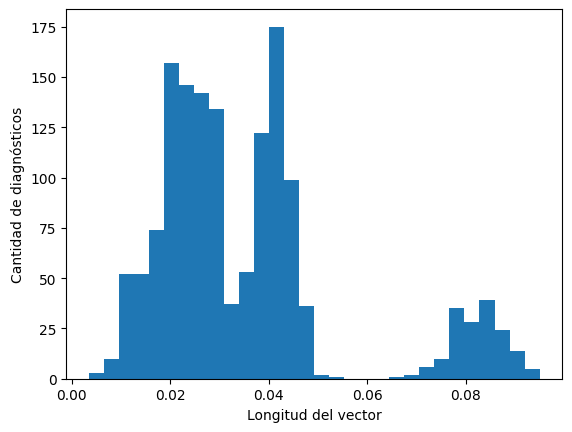

In [17]:
# Calcular y graficar la longitud de los vectores

import matplotlib.pyplot as plt

# Calcula la longitud de cada vector
vector_lengths = [np.linalg.norm(vec) for vec in diagnosticos_vec]

# Grafica un histograma de las longitudes
plt.hist(vector_lengths, bins=30)
plt.xlabel('Longitud del vector')
plt.ylabel('Cantidad de diagnósticos')
plt.show();

In [18]:
# Visualizar los vectores con PCA

from sklearn.decomposition import PCA

# Reduce la dimensionalidad a 2
pca = PCA(n_components=2)
diagnosticos_pca = pca.fit_transform(diagnosticos_vec)

# Grafica los vectores en 2D
plt.scatter(diagnosticos_pca[:, 0], diagnosticos_pca[:, 1])
plt.xlabel('Componente principal 1')
plt.ylabel('Componente principal 2')
plt.show()

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:7                                                                                    │
│                                                                                                  │
│    4                                                                                             │
│    5 # Reduce la dimensionalidad a 2                                                             │
│    6 pca = PCA(n_components=2)                                                                   │
│ ❱  7 diagnosticos_pca = pca.fit_transform(diagnosticos_vec)                                      │
│    8                                                                                             │
│    9 # Grafica los vectores en 2D                                                                │
│   10 plt.scatter(diagnosticos_pca[:, 0], diagnosticos_pca[:, 1])                                 │
│                                                                                                  │
│ C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data                                      │
│ Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\utils\_set_output.py:140 in wrapped    │
│                                                                                                  │
│   137 │                                                                                          │
│   138 │   @wraps(f)                                                                              │
│   139 │   def wrapped(self, X, *args, **kwargs):                                                 │
│ ❱ 140 │   │   data_to_wrap = f(self, X, *args, **kwargs)                                         │
│   141 │   │   if isinstance(data_to_wrap, tuple):                                                │
│   142 │   │   │   # only wrap the first output for cross decomposition                           │
│   143 │   │   │   return (                                                                       │
│                                                                                                  │
│ C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data                                      │
│ Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\decomposition\_pca.py:462 in           │
│ fit_transform                                                                                    │
│                                                                                                  │
│   459 │   │   """                                                                                │
│   460 │   │   self._validate_params()                                                            │
│   461 │   │                                                                                      │
│ ❱ 462 │   │   U, S, Vt = self._fit(X)                                                            │
│   463 │   │   U = U[:, : self.n_components_]                                                     │
│   464 │   │                                                                                      │
│   465 │   │   if self.whiten:                                                                    │
│                                                                                                  │
│ C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data                                      │
│ Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\decomposition\_pca.py:485 in _fit      │
│                                                                                                  │
│   482 │   │   │   │   "TruncatedSVD for a possible alternative."                                 │
│   483 │   │   │   )                                                                              │
│   484 │   │                                                

# Error
Este error se produce cuando se está intentando aplicar PCA a una lista de vectores, pero algunos de estos vectores no son de la misma longitud o son `None`. El error puede deberse a que algunas de las palabras en los diagnósticos no están en el modelo Word2Vec, por lo que no se creó ningún vector para ellas.

>Para solucionar este problema, puede hacerse una comprobación adicional al calcular los vectores de los diagnósticos. Si el vector para un diagnóstico es `None` o tiene longitud cero, puede reemplazarse por un vector de ceros.

````python
diagnosticos_vec = []
for i in range(tfidf.shape[0]):
    tfidf_diag = tfidf.getrow(i)
    words_vecs = [word_to_vec[word] * tfidf_diag[0, vectorizer.vocabulary_[word]] 
                  for word in diagnosticos_split[i] if word in word_to_vec]
    if words_vecs:
        diag_vec = np.mean(words_vecs, axis=0)
    else:
        diag_vec = np.zeros(model.vector_size)  # reemplaza vectores vacíos por vectores de ceros
    diagnosticos_vec.append(diag_vec)
````

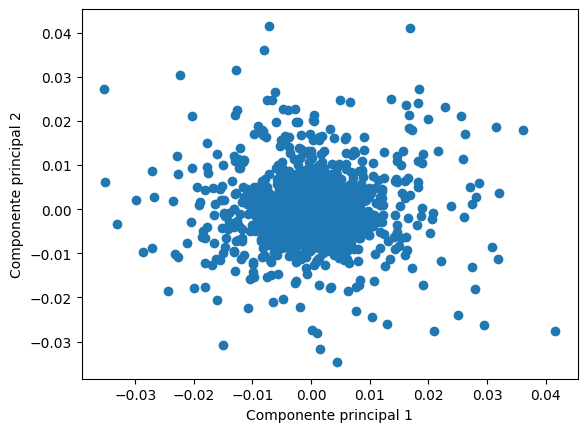

In [19]:
# Visualizar los vectores con PCA

from sklearn.decomposition import PCA

# Vectores con la misma longitud
diagnosticos_vec = []
for i in range(tfidf.shape[0]):
    tfidf_diag = tfidf.getrow(i)
    words_vecs = [word_to_vec[word] * tfidf_diag[0, vectorizer.vocabulary_[word]] 
                  for word in diagnosticos_split[i] if word in word_to_vec]
    if words_vecs:
        diag_vec = np.mean(words_vecs, axis=0)
    else:
        diag_vec = np.zeros(model.vector_size)  # reemplaza vectores vacíos por vectores de ceros
    diagnosticos_vec.append(diag_vec)
    
# Reduce la dimensionalidad a 2
pca = PCA(n_components=2)
diagnosticos_pca = pca.fit_transform(diagnosticos_vec)

# Grafica los vectores en 2D
plt.scatter(diagnosticos_pca[:, 0], diagnosticos_pca[:, 1])
plt.xlabel('Componente principal 1')
plt.ylabel('Componente principal 2')
plt.show()

In [20]:
import plotly.graph_objects as go

# Reduce la dimensionalidad a 3
pca = PCA(n_components=3)
diagnosticos_pca = pca.fit_transform(diagnosticos_vec)

# Crea el gráfico de dispersión 3D
fig = go.Figure(data=[go.Scatter3d(
    x=diagnosticos_pca[:, 0],
    y=diagnosticos_pca[:, 1],
    z=diagnosticos_pca[:, 2],
    mode='markers',
    marker=dict(
        size=6,
        color='blue',                # color de los puntos
        opacity=0.8
    )
)])

# Actualiza los ejes del gráfico
fig.update_layout(
    scene = dict(
        xaxis_title='1',
        yaxis_title='2',
        zaxis_title='3'
    )
)

fig.show()


In [21]:
import plotly.graph_objects as go

# Reduce la dimensionalidad a 3
pca = PCA(n_components=3)
diagnosticos_pca = pca.fit_transform(diagnosticos_vec)

# Crea el gráfico de dispersión 3D
fig = go.Figure(data=[go.Scatter3d(
    x=diagnosticos_pca[:, 0],
    y=diagnosticos_pca[:, 1],
    z=diagnosticos_pca[:, 2],
    mode='markers',
    marker=dict(
        size=6,
        color=diagnosticos_pca[:, 2],   # utiliza la tercera componente para el color
        colorscale='Viridis',            # elige una escala de colores
        opacity=0.8
    )
)])

# Actualiza los ejes del gráfico
fig.update_layout(
    scene = dict(
        xaxis_title='Componente principal 1',
        yaxis_title='Componente principal 2',
        zaxis_title='Componente principal 3',
        aspectmode='cube'                # hace que los ejes tengan la misma escala
    ),
    margin=dict(l=0, r=0, b=0, t=0),    # elimina los márgenes alrededor del gráfico
    scene_camera=dict(eye=dict(x=1.5, y=1.5, z=0.8))   # ajusta la posición inicial de la cámara
)

fig.show()

# la opción aspectmode='cube' es para hacer que los ejes tengan la misma escala,
# lo que puede hacer que la visualización sea más fácil de interpretar.


# 4. Calculo los Vectores

## 4.1 Máximo (toma el valor máximo de cada dimensión a través de todas las palabras en el diagnóstico)


In [22]:
import numpy as np

diagnosticos_vec_max = [np.max([model.wv[word] for word in diagnostico], axis=0) 
                        if diagnostico else np.zeros(model.vector_size) 
                        for diagnostico in diagnosticos_split]

In [23]:
from sklearn.cluster import KMeans

# Entonces podemos entrenar un modelo KMeans en estos vectores.
kmeans = KMeans(n_clusters=5)  # Ajusta este número a la cantidad de grupos que creas adecuada
kmeans.fit(diagnosticos_vec_max)

# Ahora podemos obtener las etiquetas de los grupos para cada diagnóstico
labels = kmeans.labels_

[06/29/23 15:29:35] WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\cluster\_kme                
                             ans.py:870: FutureWarning:                                                            
                                                                                                                   
                             The default value of `n_init` will change from 10 to 'auto' in 1.4.                   
                             Set the value of `n_init` explicitly to suppress the warning                          
                                                                                                                   
                                                                                                                   

## 4.2 Suma (suma los vectores de todas las palabras en el diagnóstico)

In [24]:
diagnosticos_vec_sum = [np.sum([model.wv[word] for word in diagnostico], axis=0) for diagnostico in diagnosticos_split]

## 4.3 Promedio (promediando los vectores de todas las palabras en cada diagnóstico)

In [25]:
diagnosticos_vec_mean = [np.mean([model.wv[word] for word in diagnostico], axis=0) 
                         if diagnostico else np.zeros(model.vector_size) 
                         for diagnostico in diagnosticos_split]

## 4.4 Concatenación (concatena los vectores de todas las palabras en el diagnóstico)

Este método requerirá que todas las listas de diagnósticos tengan la misma longitud (es decir, el mismo número de palabras). Si no es así, tendrás que rellenar las listas más cortas con algún valor (como un vector de ceros).

> Este último método puede resultar en vectores muy largos si los diagnósticos contienen muchas palabras, lo que puede hacer que los modelos de aprendizaje automático sean más difíciles de entrenar.

In [26]:
from keras.preprocessing.sequence import pad_sequences

# Asumimos que 'max_len' es la longitud del diagnóstico más largo en 'diagnosticos_split'
max_len = max([len(diagnostico) for diagnostico in diagnosticos_split])

diagnosticos_pad = pad_sequences(diagnosticos_split, maxlen=max_len, dtype='float32', padding='post')
'''pad_sequences se utiliza para garantizar que todas las secuencias (en este caso, listas de vectores de palabras) 
tengan la misma longitud añadiendo "relleno" según sea necesario. Este relleno se hace con vectores de ceros, 
que son de tipo float32, para que coincidan con el tipo de datos de los vectores de palabras existentes.'''

diagnosticos_vec_concat = [np.concatenate([model.wv[word] for word in diagnostico]) for diagnostico in diagnosticos_pad]

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:1                                                                                    │
│                                                                                                  │
│ ❱  1 from keras.preprocessing.sequence import pad_sequences                                      │
│    2                                                                                             │
│    3 # Asumimos que 'max_len' es la longitud del diagnóstico más largo en 'diagnosticos_split    │
│    4 max_len = max([len(diagnostico) for diagnostico in diagnosticos_split])                     │
╰──────────────────────────────────────────────────────────────────────────────────────────────────╯
ImportError: cannot import name 'pad_sequences' from 'keras.preprocessing.sequence' (C:\Users\Pablo 
Villar\Desktop\CURSOS\KSchool\Máster en Data 
Science\TFM\nuevo_entorno_kedro\lib\site-packages\keras\preprocessing\sequence.py)

>Ahora que tenemos los vectores de diagnóstico (ya sea máximo, suma, promedio o concatenación), pueden usarse como entrada para un algoritmo de aprendizaje automático o análisis de datos. Por ejemplo, estos vectores pueden alimentar a un algoritmo de clustering para agrupar diagnósticos similares, o a un algoritmo de clasificación para predecir alguna etiqueta basada en el texto del diagnóstico.

# Funciones

> Cuando tenemos un modelo Word2Vec model y una lista de diagnósticos divididos en palabras data_split podemos realizar estas funciones

Estas funciones realizan los siguientes pasos:
<hr>

* **create_vectors**: Crea vectores para los diagnósticos utilizando el método especificado (máximo, suma, media).

* **cluster_diagnosticos**: Aplica el algoritmo KMeans a los vectores de los diagnósticos.

* **create_clusters**: Crea un diccionario donde las llaves son las etiquetas de los clusters y los valores son las listas de diagnósticos que pertenecen a cada cluster.

* **print_clusters**: Imprime los diagnósticos en cada cluster.

* **print_top_words**: Imprime las palabras más comunes en cada cluster.
<hr>

* Código:
````python
import numpy as np
from sklearn.cluster import KMeans
import collections

def create_vectors(model, data_split, method='mean'):
    if method == 'max':
        data_vec = [np.max([model.wv[word] for word in data_item], axis=0) 
                            if data_item else np.zeros(model.vector_size) 
                            for data_item in data_split]
    elif method == 'sum':
        data_vec = [np.sum([model.wv[word] for word in text if word in model.wv.vocab], axis=0) 
                    for text in data_split]
        
    elif method == 'mean':
        data_vec = [np.mean([model.wv[word] for word in data_item], axis=0) 
                            if data_item else np.zeros(model.vector_size) 
                            for data_item in data_split]
    return data_vec

def cluster_data(data_vec, n_clusters=5):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(data_vec)
    labels = kmeans.labels_
    return labels

def create_clusters(data_split, labels, n_clusters=5):
    clusters = {i: [] for i in range(n_clusters)}
    for data_item, label in zip(data_split, labels):
        clusters[label].append(' '.join(data_item))
    return clusters

def print_clusters(clusters):
    for label, data_items in clusters.items():
        print(f'Cluster {label}:')
        for data_item in data_items:
            print(f'  {data_item}')

def print_top_words(clusters, n_words=10):
    for label, data_items in clusters.items():
        words = [word for data_item in data_items for word in data_item.split()]
        word_counts = collections.Counter(words)
        print(f'Cluster {label}:')
        for word, count in word_counts.most_common(n_words):
            print(f'  {word}: {count}')

````



In [27]:
# Hardcode con diagnosticos_split

import numpy as np
from sklearn.cluster import KMeans
import collections

def create_vectors(model, diagnosticos_split, method='mean'):
    if method == 'max':
        diagnosticos_vec = [np.max([model.wv[word] for word in diagnostico], axis=0) 
                            if diagnostico else np.zeros(model.vector_size) 
                            for diagnostico in diagnosticos_split]
    elif method == 'sum':
        diagnosticos_vec = [np.sum([model.wv[word] for word in diagnostico], axis=0) 
                            for diagnostico in diagnosticos_split]
    elif method == 'mean':
        diagnosticos_vec = [np.mean([model.wv[word] for word in diagnostico], axis=0) 
                            if diagnostico else np.zeros(model.vector_size) 
                            for diagnostico in diagnosticos_split]
    return diagnosticos_vec

def cluster_diagnosticos(diagnosticos_vec, n_clusters=5):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(diagnosticos_vec)
    labels = kmeans.labels_
    return labels

def create_clusters(diagnosticos_split, labels, n_clusters=5):
    clusters = {i: [] for i in range(n_clusters)}
    for diagnostico, label in zip(diagnosticos_split, labels):
        clusters[label].append(' '.join(diagnostico))
    return clusters

def print_clusters(clusters):
    for label, diagnosticos in clusters.items():
        print(f'Cluster {label}:')
        for diagnostico in diagnosticos:
            print(f'  {diagnostico}')

def print_top_words(clusters, n_words=10):
    for label, diagnosticos in clusters.items():
        palabras = [palabra for diagnostico in diagnosticos for palabra in diagnostico.split()]
        conteo_palabras = collections.Counter(palabras)
        print(f'Cluster {label}:')
        for palabra, conteo in conteo_palabras.most_common(n_words):
            print(f'  {palabra}: {conteo}')

In [28]:
# Genérico

import numpy as np
from sklearn.cluster import KMeans
import collections

def create_vectors(model, data_split, method='mean'):
    if method == 'max':
        data_vec = [np.max([model.wv[word] for word in data_item], axis=0) 
                            if data_item else np.zeros(model.vector_size) 
                            for data_item in data_split]
    elif method == 'sum':
        data_vec = [np.sum([model.wv[word] for word in text if word in model.wv.key_to_index], axis=0) 
                    for text in data_split]
    elif method == 'mean':
        data_vec = [np.mean([model.wv[word] for word in data_item], axis=0) 
                            if data_item else np.zeros(model.vector_size) 
                            for data_item in data_split]
    return data_vec

def cluster_data(data_vec, n_clusters=5):
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans.fit(data_vec)
    labels = kmeans.labels_
    return labels

def create_clusters(data_split, labels, n_clusters=5):
    clusters = {i: [] for i in range(n_clusters)}
    for data_item, label in zip(data_split, labels):
        clusters[label].append(' '.join(data_item))
    return clusters

def print_clusters(clusters):
    for label, data_items in clusters.items():
        print(f'Cluster {label}:')
        for data_item in data_items:
            print(f'  {data_item}')

def print_top_words(clusters, n_words=10):
    for label, data_items in clusters.items():
        words = [word for data_item in data_items for word in data_item.split()]
        word_counts = collections.Counter(words)
        print(f'Cluster {label}:')
        for word, count in word_counts.most_common(n_words):
            print(f'  {word}: {count}')

# Resumen


Los vectores que se han generado representan la semántica de los diagnósticos médicos en un espacio de características numéricas. Ahora pueden aplicarse una variedad de técnicas de aprendizaje automático y análisis de datos para explorar y hacer predicciones basadas en estos vectores. Por ejemplo:

1. **Agrupación (Clustering)**: Podrían usarse algoritmos de clustering como K-means, DBSCAN, o Agglomerative Clustering para agrupar diagnósticos similares. Esto puede ser útil para descubrir grupos de diagnósticos que son semánticamente similares.

2. **Reducción de dimensionalidad y visualización**: Podrían usarse técnicas de reducción de dimensionalidad como PCA, t-SNE, o UMAP para visualizar tus datos en 2D o 3D. Esto puede ayudar a entender la estructura y las relaciones entre los diagnósticos.

3. **Clasificación**: Si existen etiquetas para los diagnósticos (por ejemplo, si se sabe a qué categoría de enfermedad pertenece cada diagnóstico), podría entrenarse un modelo de clasificación para predecir estas etiquetas. Algunos algoritmos que podrían considerarse incluyen regresión logística, máquinas de vectores de soporte (SVM), árboles de decisión, y redes neuronales.

4. **Regresión**: Si hay una variable objetivo continua (por ejemplo, la duración del tratamiento o el costo del tratamiento), podría entrenarse un modelo de regresión para predecir esta variable basándote en el diagnóstico.

5. **Análisis de sentimientos**: Aunque los diagnósticos médicos no suelen tener un "sentimiento" en el mismo sentido que las reseñas de productos o los tweets, podría ser interesante explorar si ciertas palabras o frases están asociadas con resultados más positivos o negativos.

* **Creación de vectores**: Utiliza la función `create_vectors` para transformar los datos de texto en vectores. Esta función requiere el modelo de incrustación de palabras (en este caso, un modelo Word2Vec entrenado con Gensim) y los datos de texto que se desean transformar. Además, puede especificarse un método para combinar las incrustaciones de palabras individuales en una sola incrustación por documento (por ejemplo, sumando o promediando las incrustaciones de palabras).

````python
# Para el método 'sum'
data_split = diagnosticos_split
data_vec_sum = create_vectors(model, data_split, method='sum')
````
* **Clustering**: Una vez que se tienen los datos en forma vectorial, puede utilizarse cualquier algoritmo de clustering. En este caso, se está utilizando KMeans de la biblioteca scikit-learn. Necesitará especificarse el número de clusters que se desea (en este caso, 5).
````python
labels_sum = cluster_data(data_vec_sum, n_clusters=5)
````

* **Creación de clusters**: Después de realizar el clustering, pueden organizarse los datos originales en clusters de acuerdo con las etiquetas de cluster que se han obtenido.
````python
clusters_sum = create_clusters(data_split, labels_sum, n_clusters=5)
````

* **Visualización de resultados**: Finalmente, pueden imprimirse los resultados de los clusters y mostrar las palabras más comunes en cada cluster.
````python
print_clusters(clusters_sum)

print_top_words(clusters_sum)
````



# 5. Clustering (Agupación)

In [29]:
from sklearn.cluster import KMeans

# Primero, necesitamos convertir nuestros diagnósticos a vectores.
# Podemos hacer esto promediando los vectores de todas las palabras en cada diagnóstico.
diagnosticos_vec = [np.mean([model.wv[word] for word in diagnostico], axis=0) for diagnostico in diagnosticos_split]

# Entonces podemos entrenar un modelo KMeans en estos vectores.
kmeans = KMeans(n_clusters=5)  # Ajusta este número a la cantidad de grupos que creas adecuada
kmeans.fit(diagnosticos_vec)

# Ahora podemos obtener las etiquetas de los grupos para cada diagnóstico
labels = kmeans.labels_


[06/29/23 15:29:53] WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\numpy\core\fromnumer                
                             ic.py:3432: RuntimeWarning:                                                           
                                                                                                                   
                             Mean of empty slice.                                                                  
                                                                                                                   
                                                                                                                   

                    WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\numpy\core\_methods.                
                             py:190: RuntimeWarning:                                                               
                                                                                                                   
                             invalid value encountered in double_scalars                                           
                                                                                                                   
                                                                                                                   

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <module>:9                                                                                    │
│                                                                                                  │
│    6                                                                                             │
│    7 # Entonces podemos entrenar un modelo KMeans en estos vectores.                             │
│    8 kmeans = KMeans(n_clusters=5)  # Ajusta este número a la cantidad de grupos que creas ad    │
│ ❱  9 kmeans.fit(diagnosticos_vec)                                                                │
│   10                                                                                             │
│   11 # Ahora podemos obtener las etiquetas de los grupos para cada diagnóstico                   │
│   12 labels = kmeans.labels_                                                                     │
│                                                                                                  │
│ C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data                                      │
│ Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\cluster\_kmeans.py:1417 in fit         │
│                                                                                                  │
│   1414 │   │   """                                                                               │
│   1415 │   │   self._validate_params()                                                           │
│   1416 │   │                                                                                     │
│ ❱ 1417 │   │   X = self._validate_data(                                                          │
│   1418 │   │   │   X,                                                                            │
│   1419 │   │   │   accept_sparse="csr",                                                          │
│   1420 │   │   │   dtype=[np.float64, np.float32],                                               │
│                                                                                                  │
│ C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data                                      │
│ Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\base.py:565 in _validate_data          │
│                                                                                                  │
│    562 │   │   if no_val_X and no_val_y:                                                         │
│    563 │   │   │   raise ValueError("Validation should be done on X, y or both.")                │
│    564 │   │   elif not no_val_X and no_val_y:                                                   │
│ ❱  565 │   │   │   X = check_array(X, input_name="X", **check_params)                            │
│    566 │   │   │   out = X                                                                       │
│    567 │   │   elif no_val_X and not no_val_y:                                                   │
│    568 │   │   │   y = _check_y(y, **check_params)                                               │
│                                                                                                  │
│ C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data                                      │
│ Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\utils\validation.py:879 in check_array │
│                                                                                                  │
│    876 │   │   │   │   │   │   )                                                                 │
│    877 │   │   │   │   │   array = xp.astype(array, dtype, copy=False)                           │
│    878 │   │   │   │   else:                                                                     │
│ ❱  879 │   │   │   │   │   array = _asarray_with_order(arra

In [30]:
# Filtramos los diagnósticos vacíos
diagnosticos_split = [diagnostico for diagnostico in diagnosticos_split if diagnostico]

# Luego, volvemos a calcular los vectores de diagnósticos
diagnosticos_vec = [np.mean([model.wv[word] for word in diagnostico if word in model.wv.key_to_index], axis=0)
                    for diagnostico in diagnosticos_split]

In [31]:
from sklearn.cluster import KMeans

# Primero, necesitamos convertir nuestros diagnósticos a vectores.
# Podemos hacer esto promediando los vectores de todas las palabras en cada diagnóstico.
diagnosticos_vec = [np.mean([model.wv[word] for word in diagnostico], axis=0) for diagnostico in diagnosticos_split]

# Entonces podemos entrenar un modelo KMeans en estos vectores.
kmeans = KMeans(n_clusters=5)  # Ajusta este número a la cantidad de grupos que creas adecuada
kmeans.fit(diagnosticos_vec)

# Ahora podemos obtener las etiquetas de los grupos para cada diagnóstico
labels = kmeans.labels_

[06/29/23 15:30:07] WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\cluster\_kme                
                             ans.py:870: FutureWarning:                                                            
                                                                                                                   
                             The default value of `n_init` will change from 10 to 'auto' in 1.4.                   
                             Set the value of `n_init` explicitly to suppress the warning                          
                                                                                                                   
                                                                                                                   

In [32]:
# Crea un diccionario donde las llaves son las etiquetas del cluster y los valores son listas de diagnósticos pertenecientes a ese cluster
clusters = {i: [] for i in range(5)}  # Asegúrate de cambiar el rango para que coincida con el número de clusters que estás usando

for diagnostico, label in zip(diagnosticos_split, labels):
    clusters[label].append(' '.join(diagnostico))

# Ahora puedes imprimir los diagnósticos en cada cluster
for label, diagnosticos in clusters.items():
    print(f'Cluster {label}:')
    for diagnostico in diagnosticos:
        print(f'  {diagnostico}')


Cluster 0:
  cirrosis hepatica
  adenoca pulmon
  neumonia
  melanoma fosa nasal
  demencia fallo multiorganico
  ulceras mmii
  smd
  fractura cadera
  fallo cardiaco
  amputacion
  fractura vertebral
  ulceras vasculares
  sindrome general
  politraumatismo
  sindrome febril irc
  caepidermoide labio
  sifilis terciaria cardiopatia congenita
  craneofaringioma
  lma
  amputacion transmetatarsiana
  ela
  bronquiectasias
  carcinoma sigma
  colangiocarcinima
  fractura d12
  ucera mid
  broncoaspiracion
  fibrosis pulmonar
  trombocitemia esencial
  neo colon
  anemia proceso cronico demencia
  tumor vesical
  ulceras miembro inferior derecho
  deteriioro cogitivo grave
  gastroenteritis
  bronquiectasias infectadas
  glioblastoma
  sarcoma indiferenciado progresion
  parkinson
  amputacion ulceras pie izquierdo
  glioblastoma multiforme
  deshidratacion
  broquiectasias
  leucemia aguda
  meningitis postoperatoria
  ulceras multiples
  neo biliar
  epidermoide paranasales
  hepatocar

In [33]:
for diagnostico, label in zip(diagnosticos_split, labels):
    clusters[label].append(' '.join(diagnostico))
    
    '''Estás iterando sobre tus diagnósticos y sus etiquetas de cluster correspondientes. 
    Para cada diagnóstico, transformas la lista de palabras en una cadena de texto (usando ' '.join(diagnostico)) 
    y la añades a la lista correspondiente en el diccionario clusters.
    
    Por ejemplo, si tienes un diagnóstico que es ["neoplasia", "pancreas"] y su etiqueta de cluster es 2,
    este diagnóstico se transformaría en la cadena de texto "neoplasia pancreas" y se añadiría a la lista de diagnósticos
    del cluster 2 en el diccionario clusters. Así, al final, tendrías un diccionario donde para cada cluster, 
    tienes una lista de todos los diagnósticos (como cadenas de texto) que pertenecen a ese cluster'''

También puedes querer investigar las palabras más representativas de cada cluster. Esto puede darte una idea de las características que el modelo está utilizando para distinguir entre los diferentes clusters. Aquí te dejo un código de ejemplo para hacer eso:

In [34]:
import collections
# Para cada cluster, encuentra las 10 palabras más comunes
for label, diagnosticos in clusters.items():
    # Juntamos todos los diagnósticos en una sola lista de palabras
    palabras = [palabra for diagnostico in diagnosticos for palabra in diagnostico.split()]
    
    # Contamos las ocurrencias de cada palabra
    conteo_palabras = collections.Counter(palabras)
    
    print(f'Cluster {label}:')
    for palabra, conteo in conteo_palabras.most_common(10):
        print(f'  {palabra}: {conteo}')


Cluster 0:
  ulceras: 66
  ulcera: 56
  carcinoma: 48
  demencia: 38
  sindrome: 34
  amputacion: 30
  neumonia: 26
  pie: 22
  leucemia: 22
  fragil: 22
Cluster 1:
  infeccion: 168
  respiratoria: 48
  urinaria: 36
  epoc: 30
  masa: 26
  enfermedad: 26
  recto: 16
  linfoma: 16
  adenocarcinoma: 14
  anemia: 12
Cluster 2:
  cancer: 280
  epidermoide: 26
  colon: 24
  pulmon: 24
  prostata: 16
  gastrico: 14
  recto: 14
  IV: 12
  pancreas: 8
  vejiga: 8
Cluster 3:
  insuficiencia: 126
  cardiaca: 94
  cronica: 92
  neoplasia: 86
  (infeccion: 78
  tracto: 78
  urinario): 78
  ITU: 76
  deterioro: 66
  cognitivo: 52
Cluster 4:
  IV: 266
  estadio: 254
  cancer: 88
  neoplasia: 38
  colon: 32
  pulmon: 32
  adenocarcinoma: 28
  demencia: 22
  neo: 22
  prostata: 18


* Cluster 0: Este cluster parece estar relacionado con infecciones y enfermedades cognitivas. Las palabras más comunes son "infección", "cognitivo" y "deterioro". También se mencionan varias veces enfermedades como el cáncer y la demencia. Podríamos inferir que este cluster agrupa diagnósticos relacionados con infecciones y trastornos cognitivos.

* Cluster 1: Este cluster parece centrarse en condiciones de la piel y órganos internos, con palabras como "úlcera", "absceso", y "cirrosis". La neumonía y el bypass también se mencionan, lo que indica la presencia de condiciones respiratorias y cardiovasculares. Este cluster podría representar a pacientes con una variedad de condiciones, principalmente dermatológicas y gastrointestinales.

* Cluster 2: Este cluster tiene un enfoque muy fuerte en el cáncer, con palabras como "cáncer", "estadio", "neoplasia", "adenocarcinoma", "carcinoma" y "colon". Podemos inferir que este cluster está relacionado con diagnósticos de cáncer, particularmente cáncer de pulmón y de colon.

* Cluster 3: Este cluster también parece estar relacionado con el cáncer, pero incluye otras condiciones como la EPOC (Enfermedad Pulmonar Obstructiva Crónica) y la anemia. Se mencionan varios tipos de cáncer, incluyendo cáncer epidermoide, de pulmón, de colon y de páncreas. Este cluster podría representar a pacientes con una variedad de condiciones, pero con un enfoque en el cáncer.

* Cluster 4: Este cluster parece centrarse en enfermedades graves en etapas avanzadas, con palabras como "IV" (probablemente se refiere a la etapa 4), "estadio", "neoplasia" y "insuficiencia". También se mencionan varias condiciones, incluyendo cáncer de colon y pulmón, y la isquemia. Este cluster podría representar a pacientes con enfermedades en etapas avanzadas, particularmente cáncer y enfermedades cardiovasculares..

>Estos clusters pueden ser útiles para entender qué tipos de diagnósticos se agrupan juntos y podrían ayudar en tareas como el análisis de datos, la recomendación de tratamientos, o la identificación de patrones en los diagnósticos.

- Es importante recordar que estos clusters se basan en la similitud de las palabras en los diagnósticos, que no necesariamente reflejan la similitud en las condiciones médicas que representan. Por lo tanto, cualquier interpretación o aplicación de estos clusters debe hacerse con cuidado y, preferiblemente, con la validación de un experto médico.

## 5.1 MEAN

In [35]:
# El `model` es un modelo Word2Vec y `data_split` es una lista de diagnósticos divididos en palabras
data_split = diagnosticos_split
# Para el método 'mean'
data_vec_mean = create_vectors(model, data_split, method='mean')
labels_mean = cluster_data(data_vec_mean, n_clusters=5)
clusters_mean = create_clusters(data_split, labels_mean, n_clusters=5)
print_clusters(clusters_mean)
print("="*80)
print_top_words(clusters_mean)


[06/29/23 15:30:55] WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\cluster\_kme                
                             ans.py:870: FutureWarning:                                                            
                                                                                                                   
                             The default value of `n_init` will change from 10 to 'auto' in 1.4.                   
                             Set the value of `n_init` explicitly to suppress the warning                          
                                                                                                                   
                                                                                                                   

Cluster 0:
  deterioro general
  sepsisi respiratoria
  demencia fallo multiorganico
  ITU (infeccion tracto urinario)
  amputacion
  infeccion herida quirurgica
  sindrome general
  ictus
  sindrome febril irc
  ITU (infeccion tracto urinario) asintomatica
  oclusion intestinal
  isquemia eeii
  amputacion transmetatarsiana
  ela
  bronquiectasias
  anciano fragil
  deterioro general trastorno metabolico
  bronquiectasias infectadas
  bronquiectasias sobreinfectadas
  masa abdominal anexial
  esquizofreniaanciano fragil
  oclusion intestinal esquizofrenia paranoide
  deshidratacion
  cancer sigma met hepaticas
  sde mielodisplasico
  ITU (infeccion tracto urinario) klebsiella transplante renal
  ITU (infeccion tracto urinario) klebsiella
  ITU (infeccion tracto urinario) hepatopatia cronica
  tumor malar
  sindrome febril
  demencia severa
  hematoma infectado
  colostomia curas
  fibrosis pulmonar idiopatica
  si mielodisplasico
  enf charcot infeccion herida quirurgica
  anemia ferr

## 5.2 MAX

In [40]:
# Para el método 'max'
data_split = diagnosticos_split

data_vec_max = create_vectors(model, data_split, method='max')
labels_max = cluster_data(data_vec_max, n_clusters=5)
clusters_max = create_clusters(data_split, labels_max, n_clusters=5)
print_clusters(clusters_max)
print("="*80)
print_top_words(clusters_max)

[06/29/23 15:31:04] WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\cluster\_kme                
                             ans.py:870: FutureWarning:                                                            
                                                                                                                   
                             The default value of `n_init` will change from 10 to 'auto' in 1.4.                   
                             Set the value of `n_init` explicitly to suppress the warning                          
                                                                                                                   
                                                                                                                   

Cluster 0:
  melanoma vulvar
  adenoca pulmon
  fx meseta tibial
  deterioro general
  tumor cerebral
  infeccion respiratoria
  bocio intratoracico
  sepsisi respiratoria
  intolerancia oral
  esclerosis multiple
  ulceras mmii
  fractura cadera
  fallo cardiaco
  fractura vertebral
  ulceras vasculares
  deterioro cognitivo
  miocardiopatia hipertrofica
  sindrome general
  masa abdominal
  hepatopatia cronica
  adenoca recto
  diverticulitis aguda
  caepidermoide labio
  mieloma multiple
  oclusion intestinal
  isquemia eeii
  sepsis urinaria
  amputacion transmetatarsiana
  carcinoma sigma
  infeccion material
  fractura d12
  ucera mid
  fibrosis pulmonar
  anciano fragil
  linfoma hodking
  trombocitemia esencial
  neo colon
  anemia cronicaneo colon
  alzheimertromboembolismo pulmonar
  tumor vesical
  deteriioro cogitivo grave
  anoxia cerebral
  sindrome mielodisplasico
  bronquiectasias infectadas
  talasemiasindrome anemico
  masa abdominal anexial
  esquizofreniaanciano fra

## 5.3 SUM

In [44]:
# Para el método 'sum'
data_split = diagnosticos_split

data_vec_sum = create_vectors(model, data_split, method='sum')
labels_sum = cluster_data(data_vec_sum, n_clusters=5)
clusters_sum = create_clusters(data_split, labels_sum, n_clusters=5)
print_clusters(clusters_sum)
print("="*80)
print_top_words(clusters_sum)

[06/29/23 15:31:08] WARNING  C:\Users\Pablo Villar\Desktop\CURSOS\KSchool\Máster en Data            warnings.py:109
                             Science\TFM\nuevo_entorno_kedro\lib\site-packages\sklearn\cluster\_kme                
                             ans.py:870: FutureWarning:                                                            
                                                                                                                   
                             The default value of `n_init` will change from 10 to 'auto' in 1.4.                   
                             Set the value of `n_init` explicitly to suppress the warning                          
                                                                                                                   
                                                                                                                   

Cluster 0:
  melanoma vulvar
  cirrosis hepatica
  anemia
  adenoca pulmon
  fx meseta tibial
  deterioro general
  tumor cerebral
  adenoca colon IV
  neumonia
  niemannpick
  sarcoidosis
  infeccion urinaria fallo cardiaco
  melanoma fosa nasal
  infeccion respiratoria
  sdown
  bocio intratoracico
  sepsisi respiratoria
  intolerancia oral
  infeccion urinaria
  esclerosis multiple
  demencia fallo multiorganico
  ulceras mmii
  smd
  fractura cadera
  fallo cardiaco
  amputacion
  fractura vertebral
  acv
  ulceras vasculares
  infeccion herida quirurgica
  hsa
  deterioro cognitivo
  miocardiopatia hipertrofica
  sindrome general
  masa abdominal
  hepatopatia cronica
  politraumatismo
  melanoma
  epoc infeccion respiratoria
  adenoca recto
  ictus
  sindrome febril irc
  diverticulitis aguda
  caepidermoide labio
  sifilis terciaria cardiopatia congenita
  craneofaringioma
  mieloma multiple
  endocarditis
  oclusion intestinal
  isquemia eeii
  lma
  sepsis urinaria
  amputacio

# 6. PCA

## 6.1 PCA Mean

In [36]:
# Reducir la dimensionalidad de los vectores a 2 dimensiones con PCA:

from sklearn.decomposition import PCA

pca = PCA(n_components=2)
data_vec_2d = pca.fit_transform(data_vec_mean)


In [37]:
# Crear un DataFrame de pandas con las coordenadas 2D y las etiquetas de los clusters:

import pandas as pd

df_pca = pd.DataFrame(data_vec_2d, columns=['x', 'y'])
df_pca['cluster'] = labels_mean


In [38]:
# Visualizar los clusters con Plotly:

import plotly.express as px

fig = px.scatter(df_pca, x='x', y='y', color='cluster', width=800, height=600)
fig.update_traces(marker=dict(size=6))
fig.show()



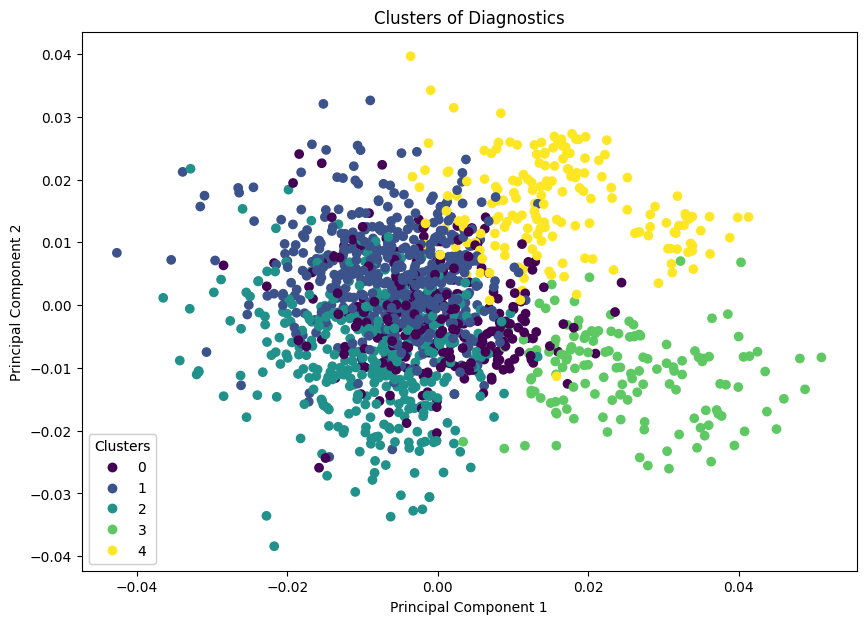

In [49]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10, 7))
scatter = ax.scatter(df_pca['x'], df_pca['y'], c=df_pca['cluster'], cmap='viridis')
ax.set_title('Clusters of Diagnostics')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')

# create legend as per color map
legend1 = ax.legend(*scatter.legend_elements(),
                    loc="lower left", title="Clusters")
ax.add_artist(legend1)

plt.show()


## 6.2 PCA Max

In [41]:
# Reducir la dimensionalidad de los vectores a 2 dimensiones con PCA:

from sklearn.decomposition import PCA

pca = PCA(n_components=2)
data_vec_2d = pca.fit_transform(data_vec_max)

In [42]:
import pandas as pd

df_pca_max = pd.DataFrame(data_vec_2d, columns=['x', 'y'])
df_pca_max['cluster'] = labels_max

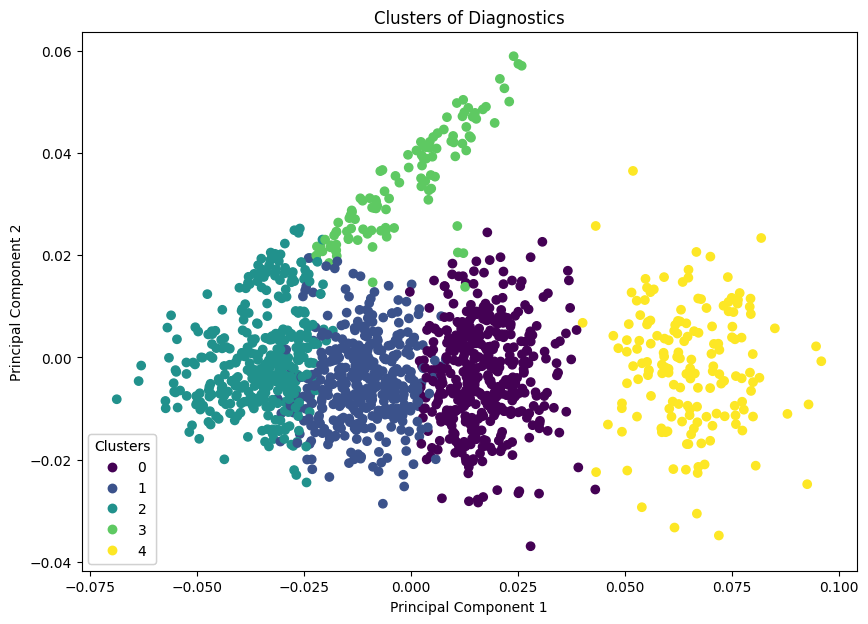

In [50]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10, 7))
scatter = ax.scatter(df_pca_max['x'], df_pca_max['y'], c=df_pca_max['cluster'], cmap='viridis')
ax.set_title('Clusters of Diagnostics')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')

# create legend as per color map
legend1 = ax.legend(*scatter.legend_elements(),
                    loc="lower left", title="Clusters")
ax.add_artist(legend1)

plt.show()

## 6.3 PCA Sum

In [45]:
# Reducir la dimensionalidad de los vectores a 2 dimensiones con PCA:

from sklearn.decomposition import PCA

pca = PCA(n_components=2)
data_vec_2d = pca.fit_transform(data_vec_sum)

In [46]:
import pandas as pd

df_pca_sum = pd.DataFrame(data_vec_2d, columns=['x', 'y'])
df_pca_sum['cluster'] = labels_sum

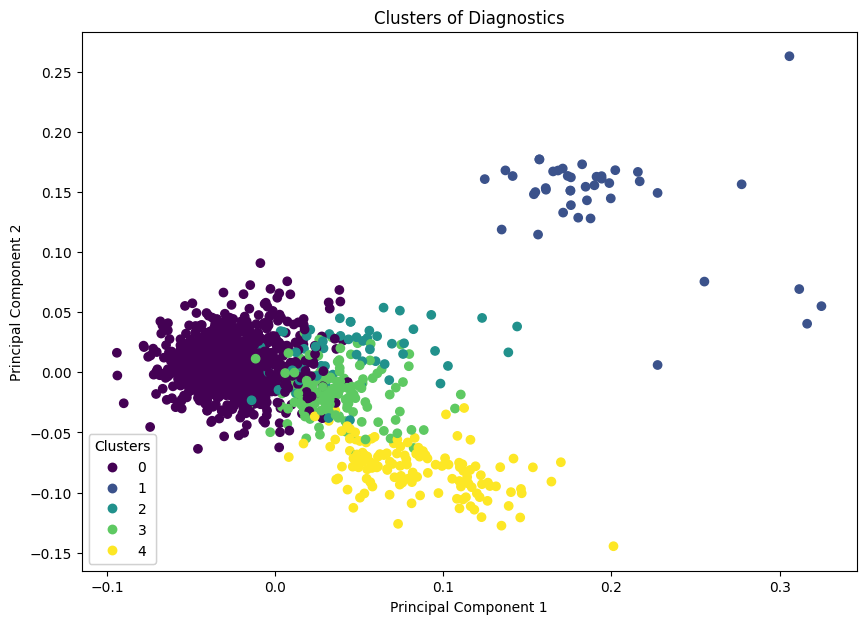

In [51]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(10, 7))
scatter = ax.scatter(df_pca_sum['x'], df_pca_sum['y'], c=df_pca_sum['cluster'], cmap='viridis')
ax.set_title('Clusters of Diagnostics')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')

# create legend as per color map
legend1 = ax.legend(*scatter.legend_elements(),
                    loc="lower left", title="Clusters")
ax.add_artist(legend1)

plt.show()

In [48]:
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go

init_notebook_mode(connected=True)

trace = go.Scatter(
    x = df_pca_sum['x'],
    y = df_pca_sum['y'],
    mode = 'markers',
    marker=dict(
        size=6,
        color = df_pca_sum['cluster'], # set color equal to a variable
        colorscale='Viridis',
        showscale=True
    )
)

data = [trace]

fig = go.Figure(data=data)

iplot(fig)


# Estrategia
Una estrategia que podrías considerar es usar una combinación de estas métricas para obtener una visión más completa de tus datos. Por ejemplo, podrías usar la métrica mean para identificar las palabras que son más representativas de cada cluster en promedio, y luego usar la métrica max para identificar los temas o categorías que son más comunes en tus datos. Luego, podrías usar la métrica sum para obtener una visión general de qué palabras son más prevalentes en tus datos.

# 7. Análisis de grupos: 

Podría realizarse un análisis más profundo de cada grupo. Por ejemplo, examinar las características de los pacientes dentro de cada grupo para ver si hay alguna característica que distinga a los pacientes en un grupo de los pacientes en otro grupo.

In [67]:
df_copy = df.copy()
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4014 entries, 0 to 4013
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   h_procedencia         4014 non-null   object
 1   s_procedencia         4014 non-null   object
 2   ap                    4013 non-null   object
 3   otros                 2958 non-null   object
 4   diagnostico           4014 non-null   object
 5   motivo_ing            4014 non-null   object
 6   paliativo_onc_noc     4013 non-null   object
 7   paliativo_no_onc_noc  4012 non-null   object
 8   fiebre                4012 non-null   object
 9   disnea                4013 non-null   object
 10  dolor                 4014 non-null   object
 11  delirium              4013 non-null   object
 12  otros_1               1549 non-null   object
 13  p_terminal            1547 non-null   object
 14  agonia                2955 non-null   object
 15  ps_ecog               4013 non-null   

In [69]:
# Creamos un DataFrame con las palabras del diagnóstico y su etiqueta de grupo correspondiente
df_clusters = pd.DataFrame({'diagnostico': [' '.join(words) for words in diagnosticos_split], 'cluster': labels})

# Unimos este nuevo DataFrame con el DataFrame original
df_new = df_copy.join(df_clusters.set_index('diagnostico'), on='diagnostico')


In [71]:
df_clusters.head()

,diagnostico,cluster
0,cancer orl,2
1,melanoma vulvar,1
2,cancer broncogenico,2
3,cirrosis hepatica,0
4,neplasia mama estadio IV,4


In [72]:
df_new.head()

,h_procedencia,s_procedencia,ap,otros,diagnostico,motivo_ing,paliativo_onc_noc,paliativo_no_onc_noc,fiebre,disnea,dolor,delirium,otros_1,p_terminal,agonia,ps_ecog,barthel,gds_fast,eva_ing,otros_2,otros_complicaciones,n_estancias,n_visitas,sedacion,motivo_alta,medico,year,ast_anorx,agudo_estable,cronico_reag,transfusion,paracentesis,toracocentesis,ayuntamiento,fecha_alta,¿?,toracocen,cluster
0,gil casares,upal,no,no,cancer orl,control de sintomas,si,si,no,no,si,no,no,si,no,40,300,no,no,no,reingreso en urgencias,210,100,no,reingreso,valdes,2017,si,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0
1,clinico,oncologia,no,no,melanoma vulvar,mal control dolor,si,no,no,no,si,no,no,si,no,34,no,no,no,no,met pulmonares y digest,240,80,no,exitus,galego feal,2017,si,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
2,clinico,mir,no,no,cancer broncogenico,control evolutivo,si,si,no,si,no,no,no,no,no,34,400,no,no,no,no,140,60,no,fin de cuidados,lopez renedo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0
3,clinico,digestivo,no,no,cirrosis hepatica,admininistacion octreotido,no,no,no,no,no,no,no,no,no,10,900,no,no,no,no,10,10,no,fin de cuidados,lopez renedo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0
4,clinico,urgencias,no,no,neplasia mama estadio IV,control de sintomas,si,no,no,si,si,no,no,si,no,40,300,no,70,no,no,20,10,no,exitus,lopez renedo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0


In [75]:
# Tamaño de los grupos
df_new['cluster'].value_counts()


0.0    1096
3.0     939
1.0     811
2.0     610
4.0     557
Name: cluster, dtype: int64

In [76]:
# Análisis de las características de los pacientes dentro de cada grupo
df_new.groupby('cluster').describe()

n_estancias                                                        \
              count          mean           std   min   25%    50%    75%   
cluster                                                                     
0.0          1096.0    178.060219  3.765919e+02  10.0  40.0   90.0  200.0   
1.0           811.0    136.145499  3.705033e+02   0.0  40.0   80.0  140.0   
2.0           610.0  45973.803279  1.131216e+06   0.0  50.0  100.0  220.0   
3.0           939.0    152.517572  3.723864e+02   0.0  40.0   80.0  150.0   
4.0           557.0    173.342908  3.527945e+02   0.0  40.0  100.0  220.0   

                    n_visitas                                               \
                max     count       mean        std  min   25%   50%   75%   
cluster                                                                      
0.0          7122.0    1096.0  61.496350  74.547928  0.0  20.0  40.0  70.0   
1.0          7122.0     811.0  51.454994  54.365965  0.0  20.0  40.0  60.0   
2.0      27939140.0     610.0  77.606557  83.584569  0.0  30.0  50.0  90.0   
3.0          7122.0     939.0  54.057508  65.158826  0.0  20.0  40.0  60.0   
4.0          7122.0     557.0  61.903052  65.970655  0.0  20.0  40.0  80.0   

                  year                                                         \
           max   count         mean       std     min     25%     50%     75%   
cluster                                                                         
0.0      800.0  1096.0  2020.005474  1.794453  2017.0  2018.0  2020.0  2022.0   
1.0      760.0   811.0  2019.921085  1.825387  2017.0  2018.0  2020.0  2022.0   
2.0      710.0   610.0  2019.404918  1.766773  2017.0  2018.0  2019.0  2021.0   
3.0      990.0   939.0  2020.145900  1.711311  2017.0  2019.0  2020.0  2022.0   
4.0      490.0   557.0  2019.820467  1.753746  2017.0  2018.0  2020.0  2021.0   

                 
            max  
cluster          
0.0      2022.0  
1.0      2022.0  
2.0      2022.0  
3.0      2022.0  
4.0      2022.0

<Axes: xlabel='cluster', ylabel='year'>

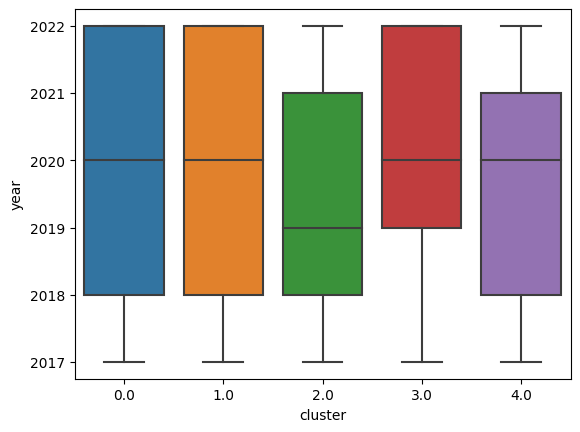

In [78]:
# Visualización de las características de los pacientes dentro de cada grupo

import seaborn as sns

sns.boxplot(x='cluster', y='year', data=df_new)


<Axes: xlabel='cluster', ylabel='n_visitas'>

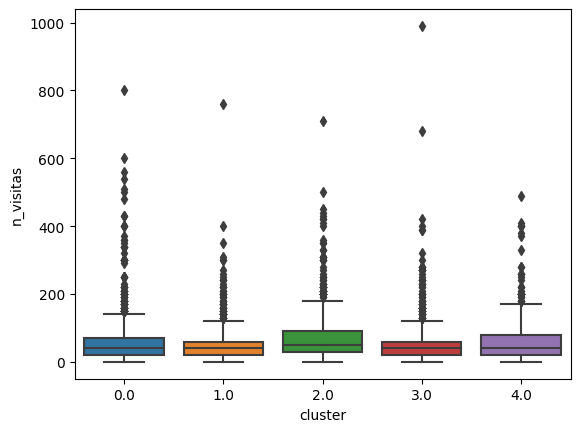

In [79]:
sns.boxplot(x='cluster', y='n_visitas', data=df_new)

<Axes: xlabel='cluster', ylabel='n_estancias'>

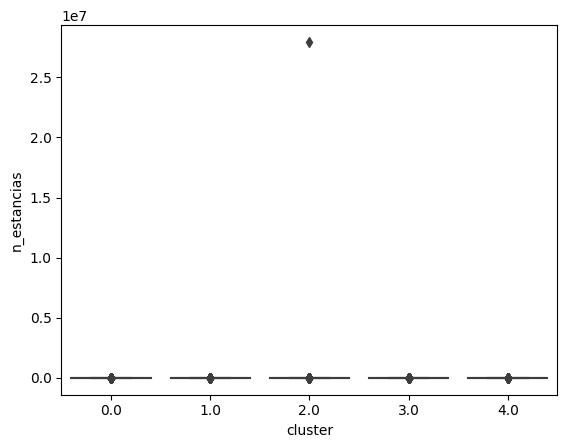

In [80]:
sns.boxplot(x='cluster', y='n_estancias', data=df_new)

## 7.1 Análisis de la procedencia

In [84]:
print(df_new.groupby('cluster')['h_procedencia'].value_counts())

cluster  h_procedencia       
0.0      clinico                 620
         no                      346
         conxo                    90
         gil casares              30
         chuac                     3
         provincial                2
         rosaleda                  2
         pontevedra                1
         residencia                1
         si                        1
1.0      clinico                 444
         no                      252
         conxo                    65
         gil casares              40
         provincial                7
         chuac                     1
         lucus augusti             1
         salnes                    1
2.0      clinico                 385
         no                      159
         conxo                    33
         gil casares              29
         residencia                2
         rosaleda                  1
         san rafael la coruna      1
3.0      clinico                 474
        

In [85]:
print(df_new.groupby('cluster')['s_procedencia'].value_counts())

cluster  s_procedencia                      
0.0      no                                     338
         mir                                    110
         neumologia                              92
         urgencias                               91
         acv                                     66
         oncologia                               62
         digestivo                               56
         upal                                    48
         hematologia                             38
         cirugia vascular                        16
         neurologia                              14
         cgd                                     13
         ncr                                     12
         umap                                    12
         mir provincial                          10
         cardiologia                              9
         traumatologia                            8
         cirugia plastica                         7
         cot       

## 7.2 Análisis del motivo de ingreso por cluster

In [86]:
print(df_new.groupby('cluster')['motivo_ing'].value_counts())

cluster  motivo_ing                                                                                                           
0.0      control de sintomas                                                                                                      197
         antibioterapia IV                                                                                                        107
         tratamiento antibiotico IV                                                                                                94
         curas                                                                                                                     53
         control sintomas                                                                                                          49
         valoracion                                                                                                                36
         continuacion de cuidados                                    

## 7.3 Análisis de la duración de la estancia (n_estancias) por cluster

In [87]:
print(df_new.groupby('cluster')['n_estancias'].describe())

          count          mean           std   min   25%    50%    75%  \
cluster                                                                 
0.0      1096.0    178.060219  3.765919e+02  10.0  40.0   90.0  200.0   
1.0       811.0    136.145499  3.705033e+02   0.0  40.0   80.0  140.0   
2.0       610.0  45973.803279  1.131216e+06   0.0  50.0  100.0  220.0   
3.0       939.0    152.517572  3.723864e+02   0.0  40.0   80.0  150.0   
4.0       557.0    173.342908  3.527945e+02   0.0  40.0  100.0  220.0   

                max  
cluster              
0.0          7122.0  
1.0          7122.0  
2.0      27939140.0  
3.0          7122.0  
4.0          7122.0  


## 7.4 Análisis del médico asignado (medico) por cluster

In [89]:
print(df_new.groupby('cluster')['medico'].value_counts())

cluster  medico             
0.0      fernandez benito       276
         galego feal            162
         villar del castillo    140
         suarez                 125
         lopez renedo           118
         novo                    64
         valdes                  51
         gomez buela             41
         suarez prado            36
         valcarcel               30
         ibanez alonso           17
         beceiro                 14
         masa                    13
         masa vazquez             8
         200                      1
1.0      villar del castillo    187
         fernandez benito       143
         lopez renedo           119
         galego feal             84
         suarez                  70
         novo                    49
         suarez prado            32
         ibanez alonso           30
         valdes                  30
         gomez buela             24
         valcarcel               18
         beceiro                 13

# 8. Análisis de frecuencia 

## 8.1 Por palabra clave en los diagnósticos

In [56]:
print(len(diagnosticos_split), diagnosticos_split)

1459 [['cancer', 'orl'], ['melanoma', 'vulvar'], ['cancer', 'broncogenico'], ['cirrosis', 'hepatica'], ['neplasia', 'mama', 'estadio', 'IV'], ['anemia'], ['adenoca', 'pulmon'], ['leucemia', 'linfatica', 'cronica'], ['fx', 'meseta', 'tibial'], ['cancer', 'mama'], ['cancer', 'prostata'], ['deterioro', 'general'], ['tumor', 'cerebral'], ['adenoca', 'colon', 'IV'], ['cancer', 'colon'], ['neumonia'], ['niemannpick'], ['sarcoidosis'], ['cancer', 'pancreas'], ['infeccion', 'urinaria', 'fallo', 'cardiaco'], ['melanoma', 'fosa', 'nasal'], ['cancer', 'timo'], ['infeccion', 'respiratoria'], ['sdown'], ['bocio', 'intratoracico'], ['sepsisi', 'respiratoria'], ['intolerancia', 'oral'], ['infeccion', 'urinaria'], ['esclerosis', 'multiple'], ['demencia', 'fallo', 'multiorganico'], ['cancer', 'parotida'], ['ITU', '(infeccion', 'tracto', 'urinario)'], ['ulceras', 'mmii'], ['smd'], ['cancer', 'colon', 'estadio', 'IV'], ['fractura', 'cadera'], ['fallo', 'cardiaco'], ['cancer', 'endometrio'], ['cancer', 's

In [91]:
from collections import Counter

# Concatena todas las listas de palabras en una sola lista
all_words = [word for sublist in diagnosticos_split for word in sublist]

# Cuenta la frecuencia de cada palabra
word_freq = Counter(all_words)

# Muestra las 10 palabras más comunes
most_common_words = word_freq.most_common(30)
most_common_words

[('cancer', 196),
 ('IV', 147),
 ('estadio', 138),
 ('infeccion', 103),
 ('insuficiencia', 72),
 ('neoplasia', 63),
 ('cardiaca', 52),
 ('cronica', 50),
 ('colon', 46),
 ('respiratoria', 45),
 ('tracto', 43),
 ('pulmon', 42),
 ('(infeccion', 42),
 ('urinario)', 42),
 ('ITU', 41),
 ('cognitivo', 41),
 ('ulcera', 38),
 ('deterioro', 36),
 ('demencia', 35),
 ('ulceras', 34),
 ('fragil', 28),
 ('carcinoma', 27),
 ('adenocarcinoma', 27),
 ('renal', 26),
 ('recto', 25),
 ('aguda', 24),
 ('prostata', 23),
 ('urinaria', 23),
 ('epidermoide', 23),
 ('epoc', 22)]

## 8.2 Análisis de n-gramas

In [92]:
from nltk.util import ngrams

# Genera bigramas
bigrams = list(ngrams(all_words, 2))

# Cuenta la frecuencia de cada bigrama
bigram_freq = Counter(bigrams)

# Muestra los 10 bigramas más comunes
most_common_bigrams = bigram_freq.most_common(30)
most_common_bigrams


[(('estadio', 'IV'), 122),
 (('insuficiencia', 'cardiaca'), 51),
 (('(infeccion', 'tracto'), 42),
 (('tracto', 'urinario)'), 42),
 (('ITU', '(infeccion'), 41),
 (('infeccion', 'respiratoria'), 30),
 (('deterioro', 'cognitivo'), 27),
 (('cardiaca', 'cronica'), 27),
 (('IV', 'cancer'), 24),
 (('cancer', 'colon'), 17),
 (('cancer', 'epidermoide'), 17),
 (('pulmon', 'estadio'), 16),
 (('cognitivo', 'severo'), 16),
 (('infeccion', 'urinaria'), 15),
 (('colon', 'estadio'), 15),
 (('anciana', 'fragil'), 12),
 (('anciano', 'fragil'), 11),
 (('cancer', 'prostata'), 10),
 (('cancer', 'pulmon'), 10),
 (('demencia', 'avanzada'), 10),
 (('cancer', 'recto'), 9),
 (('prostata', 'estadio'), 9),
 (('neoplasia', 'colon'), 9),
 (('grado', 'IV'), 9),
 (('insuficiencia', 'renal'), 9),
 (('cirrosis', 'hepatica'), 8),
 (('mama', 'estadio'), 8),
 (('cancer', 'gastrico'), 8),
 (('IV', 'neoplasia'), 7),
 (('recto', 'estadio'), 7)]

In [93]:
from nltk.util import ngrams

# Genera bigramas
trigrams = list(ngrams(all_words, 3))

# Cuenta la frecuencia de cada bigrama
trigram_freq = Counter(trigrams)

# Muestra los 10 bigramas más comunes
most_common_trigrams = trigram_freq.most_common(30)
most_common_trigrams

[(('(infeccion', 'tracto', 'urinario)'), 42),
 (('ITU', '(infeccion', 'tracto'), 41),
 (('insuficiencia', 'cardiaca', 'cronica'), 27),
 (('estadio', 'IV', 'cancer'), 20),
 (('pulmon', 'estadio', 'IV'), 15),
 (('colon', 'estadio', 'IV'), 13),
 (('deterioro', 'cognitivo', 'severo'), 11),
 (('prostata', 'estadio', 'IV'), 9),
 (('mama', 'estadio', 'IV'), 7),
 (('cancer', 'colon', 'estadio'), 7),
 (('estadio', 'IV', 'neoplasia'), 7),
 (('recto', 'estadio', 'IV'), 7),
 (('estadio', 'IV', 'infeccion'), 7),
 (('pancreas', 'estadio', 'IV'), 6),
 (('estadio', 'IV', 'adenocarcinoma'), 4),
 (('estadio', 'IV', 'demencia'), 4),
 (('insuficiencia', 'cardiaca', 'infeccion'), 4),
 (('obliteracion', 'femoro', 'poplitea'), 4),
 (('infeccion', 'respiratoria', 'insuficiencia'), 4),
 (('respiratoria', 'insuficiencia', 'cardiaca'), 4),
 (('infeccion', 'herida', 'quirurgica'), 3),
 (('estadio', 'IV', 'neo'), 3),
 (('ovario', 'estadio', 'IV'), 3),
 (('gastrico', 'estadio', 'IV'), 3),
 (('renal', 'estadio', 'IV

Estos análisis nos permiten ver cuáles son los diagnósticos más comunes entre los pacientes

# 9. Análisis de tendencias a lo largo del tiempo

## 9.1 Agrupación por año y diagnóstico

In [101]:
diagnostic_counts = df_new.groupby(['year', 'diagnostico']).size()
print(diagnostic_counts.info(), diagnostic_counts)

<class 'pandas.core.series.Series'>
MultiIndex: 1949 entries, (2017, 'ITU (infeccion tracto urinario)') to (2022, 'vmi insuficiencia respiratoria')
Series name: None
Non-Null Count  Dtype
--------------  -----
1949 non-null   int64
dtypes: int64(1)
memory usage: 32.5+ KB
None year  diagnostico                                                                                                                                                                                                  
2017  ITU (infeccion tracto urinario)                                                                                                                                                                                  13
      ITU (infeccion tracto urinario) asintomatica                                                                                                                                                                      1
      ITU (infeccion tracto urinario) hepatopatia cronica                  

## 9.2 Visualización de las tendencias

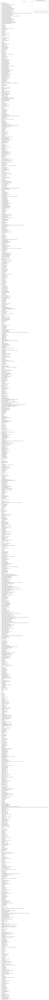

In [102]:
diagnostic_counts.unstack('diagnostico').plot(kind='line')
plt.ylabel('Count')
plt.title('Trends in Diagnoses Over Time')
plt.show();

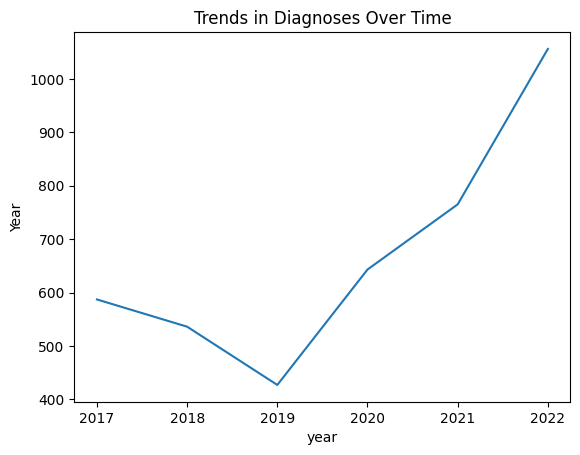

In [105]:
year_counts = df_new.groupby('year').size()
year_counts.plot(kind='line')
plt.ylabel('Count')
plt.ylabel('Year')
plt.title('Trends in Diagnoses Over Time')
plt.show()

Al tener muchos diagnósticos distintos clasificaremos por los grupos de palabras más frecuentes en los diagnósticos

## 9.3 Top palabras mas comunes y bigramas

In [108]:
# lista de palabras o bigramas a seguir
common_words = ['cancer', 'ulcera', 'respiratorio', 'infeccion', 'insuficiencia']  
common_bigrams = [('estadio', 'IV'), ('insuficiencia', 'cardiaca'), ('(infeccion', 'tracto')]


In [109]:
#  nueva columna para las palabras o bigramas comunes

def match_word(x, words):
    for word in words:
        if word in x:
            return word
    return None

def match_bigram(x, bigrams):
    words = x.split()
    for i in range(len(words) - 1):
        if (words[i], words[i+1]) in bigrams:
            return (words[i], words[i+1])
    return None

df_new['common_word'] = df_new['diagnostico'].apply(lambda x: match_word(x, common_words))
df_new['common_bigram'] = df_new['diagnostico'].apply(lambda x: match_bigram(x, common_bigrams))


In [110]:
pd.get_dummies(df_new, columns=['common_word', 'common_bigram'])

,h_procedencia,s_procedencia,ap,otros,diagnostico,motivo_ing,paliativo_onc_noc,paliativo_no_onc_noc,fiebre,disnea,dolor,delirium,otros_1,p_terminal,agonia,ps_ecog,barthel,gds_fast,eva_ing,otros_2,otros_complicaciones,n_estancias,n_visitas,sedacion,motivo_alta,medico,year,ast_anorx,agudo_estable,cronico_reag,transfusion,paracentesis,toracocentesis,ayuntamiento,fecha_alta,¿?,toracocen,cluster,common_word_cancer,common_word_infeccion,common_word_insuficiencia,common_word_respiratorio,common_word_ulcera,"common_bigram_('(infeccion', 'tracto')","common_bigram_('estadio', 'IV')","common_bigram_('insuficiencia', 'cardiaca')"
0,gil casares,upal,no,no,cancer orl,control de sintomas,si,si,no,no,si,no,no,si,no,40,300,no,no,no,reingreso en urgencias,210,100,no,reingreso,valdes,2017,si,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1,0,0,0,0,0,0,0
1,clinico,oncologia,no,no,melanoma vulvar,mal control dolor,si,no,no,no,si,no,no,si,no,34,no,no,no,no,met pulmonares y digest,240,80,no,exitus,galego feal,2017,si,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0,0,0,0,0,0,0,0
2,clinico,mir,no,no,cancer broncogenico,control evolutivo,si,si,no,si,no,no,no,no,no,34,400,no,no,no,no,140,60,no,fin de cuidados,lopez renedo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1,0,0,0,0,0,0,0
3,clinico,digestivo,no,no,cirrosis hepatica,admininistacion octreotido,no,no,no,no,no,no,no,no,no,10,900,no,no,no,no,10,10,no,fin de cuidados,lopez renedo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0,0,0,0
4,clinico,urgencias,no,no,neplasia mama estadio IV,control de sintomas,si,no,no,si,si,no,no,si,no,40,300,no,70,no,no,20,10,no,exitus,lopez renedo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,0,0,0,0,0,0,1,0
5,no,no,si,no,anemia,transfusion,no,no,no,no,no,no,no,no,no,no,500,no,no,no,no,20,20,no,fin de cuidados,villar del castillo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0,0,0,0,0,0,0,0
6,clinico,oncologia,no,no,adenoca pulmon,control de sintomas,si,no,no,si,no,no,estrenimiento,si,no,34,600,no,no,no,claud familiar domicilio,130,50,no,reingreso por urgencias a hado,valcarcel,2017,si,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,0,0,0,0,0,0,0
7,clinico,hematologia,no,no,leucemia linfatica cronica,transfusion,si,no,no,no,no,no,no,no,no,12,600,no,no,no,no,20,10,no,fin de cuidados,lopez renedo,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0,0,0,0,0,0,0,0,0
8,clinico,traumatologia,no,no,fx meseta tibial,infosteosintesis,no,no,no,no,no,no,mucositis,no,no,34,600,no,no,no,no,220,60,no,fin de cuidados,suarez,2017,no,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,0,0,0,0,0,0,0,0
9,clinico,urgencias,no,no,cancer mama,control de sintomas,si,no,no,si,si,no,no,si,no,40,60,no,no,no,no,50,30,no,exitus,suarez,2017,si,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1,0,0,0,0,0,0,0


## 9.4 One-hot encoding de las nuevas columnas

In [111]:
# One-hot encoding de las nuevas columnas

df_new = pd.get_dummies(df_new, columns=['common_word', 'common_bigram'])


In [112]:
# Agrupo por año y sumo las columnas
word_counts = df_new.filter(regex='common_word').groupby(df_new['year']).sum()
bigram_counts = df_new.filter(regex='common_bigram').groupby(df_new['year']).sum()
print(word_counts)
print(bigram_counts)

      common_word_cancer  common_word_infeccion  common_word_insuficiencia  \
year                                                                         
2017                 145                     76                         17   
2018                 140                     57                         24   
2019                 115                     49                         18   
2020                 127                    109                         43   
2021                 142                     98                         43   
2022                 138                    208                         74   

      common_word_respiratorio  common_word_ulcera  
year                                                
2017                         0                  19  
2018                         1                   7  
2019                         0                  12  
2020                         0                  27  
2021                         0                  35  
2022

## 9.5 Visualización de las tendencias

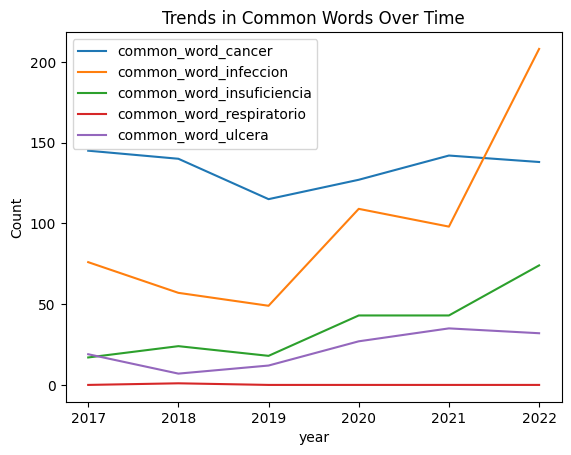

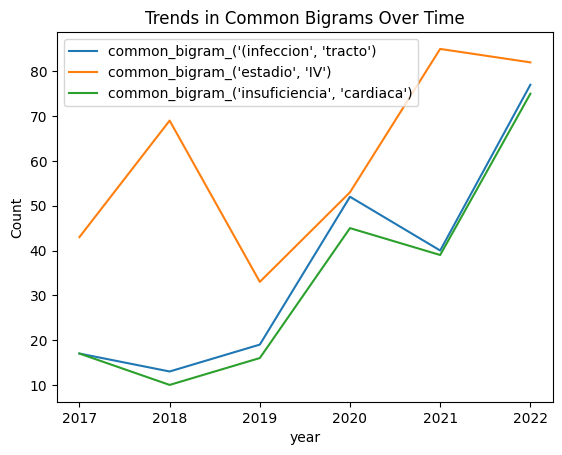

In [113]:
word_counts.plot(kind='line')
plt.ylabel('Count')
plt.title('Trends in Common Words Over Time')
plt.show()

bigram_counts.plot(kind='line')
plt.ylabel('Count')
plt.title('Trends in Common Bigrams Over Time')
plt.show()


Otros...


¡Excelente! Parece que has hecho un buen trabajo en la implementación de técnicas de análisis de texto, incluyendo la creación de vectores para representar tus diagnósticos, la agrupación de diagnósticos utilizando KMeans y la visualización de tus grupos utilizando PCA.

En este punto, ya deberías tener una buena idea de la estructura de tus datos y de cómo se agrupan los diagnósticos.

Si quisieras continuar profundizando tu análisis, aquí hay algunas ideas:

Análisis de grupos: Podrías realizar un análisis más profundo de cada grupo. Por ejemplo, podrías examinar las características de los pacientes dentro de cada grupo para ver si hay alguna característica que distinga a los pacientes en un grupo de los pacientes en otro grupo.

Análisis de tendencias a lo largo del tiempo: Si tienes datos de tiempo, podrías examinar cómo han cambiado los diagnósticos a lo largo del tiempo. ¿Han aumentado o disminuido ciertos diagnósticos? ¿Ha habido cambios en los grupos de diagnósticos a lo largo del tiempo?

Predecir diagnósticos: Si tienes un objetivo específico, como predecir un cierto diagnóstico basándote en las características de un paciente, podrías entrenar un modelo de aprendizaje automático supervisado utilizando tus vectores de diagnósticos como entrada.

Análisis de sentimiento: Si tus diagnósticos incluyen texto escrito por médicos o pacientes, podrías considerar realizar un análisis de sentimiento para entender mejor cómo se sienten los pacientes o cómo perciben su condición.

Pruebas de correlación: Podrías realizar pruebas de correlación entre diferentes variables para ver si hay alguna relación entre, por ejemplo, la edad de un paciente y el tipo de diagnóstico que recibe.